In [1]:
import sys
sys.path.insert(0, '../../python_dms/lib/')
from tools_dms import *
from dms import *
from PIL import Image
import scipy.io as sio
import matplotlib.pyplot as plt
import scipy.io
import time 
%load_ext autoreload
%autoreload 2
from skimage.metrics import structural_similarity as ssim


In [2]:
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 1.0
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

In [3]:
import os
def SegtoCon_DMS(seg):
    rows,cols = np.shape(seg)
    cont= np.zeros_like(seg)
    y=  np.zeros((rows,cols,2))
    y[:, :, 0] = np.concatenate((seg[:, 1:] - seg[:, 0:-1], np.zeros((rows, 1))),axis=1) / 2.
    y[:, :, 1] = np.concatenate((seg[1:, :] - seg[0:-1, :], np.zeros((1, cols))),axis=0) / 2.
    
    for i in range(rows):
        for j in range(cols):
            if np.abs(y[i,j,0]) > 0 or np.abs(y[i,j,1])>0:
                cont[i,j]=1
#                 im[i,j,:]=0
    return cont

def SegtoCon_DMS(seg):
    rows,cols = np.shape(seg)
    cont= np.zeros_like(seg)
    y=  np.zeros((rows,cols,2))
    y[:, :, 0] = np.concatenate((seg[:, 1:] - seg[:, 0:-1], np.zeros((rows, 1))),axis=1) / 2.
    y[:, :, 1] = np.concatenate((seg[1:, :] - seg[0:-1, :], np.zeros((1, cols))),axis=0) / 2.
    
    for i in range(rows):
        for j in range(cols):
            if np.abs(y[i,j,0]) > 0 or np.abs(y[i,j,1])>0:
                cont[i,j]=1
#                 im[i,j,:]=0
    return cont

In [4]:

np.random.seed(0)

x = np.array(Image.open('../../../../Documents/dataset/BIPED/edges/imgs/train/rgbr/real/RGB_001.jpg'))/255.

rows,cols,_ = np.shape(x)
delta= 0.04
# print(np.random.normal(0,1,x.shape).shape)
z = x+ delta*np.random.normal(0,1,x.shape)



In [5]:
original = np.copy(x)

In [6]:
PSNR(original,compressed=z)

27.96130938574409

In [7]:

## Without GGS
slpam_l1_solver = DMS(
        norm_type="l1",
        edges="similar",
        beta=8,
        lamb=1e-2,
        eps=0.2,
        stop_criterion=1e-4,
        MaximumIteration=250,
        method="SLPAM",
        noised_image_input=z,
        optD="OptD",
        dk_SLPAM_factor=1e-4,
        eps_AT_min=0.02,
        A=np.ones((rows,cols)))

In [8]:
time1 = time.time()
out_slpam_l1 = slpam_l1_solver.process()
time_slpam_l1 = time.time()-time1

100%|████████████████████████████████████████████████████████████████████████████████| 250/250 [07:45<00:00,  1.86s/it]


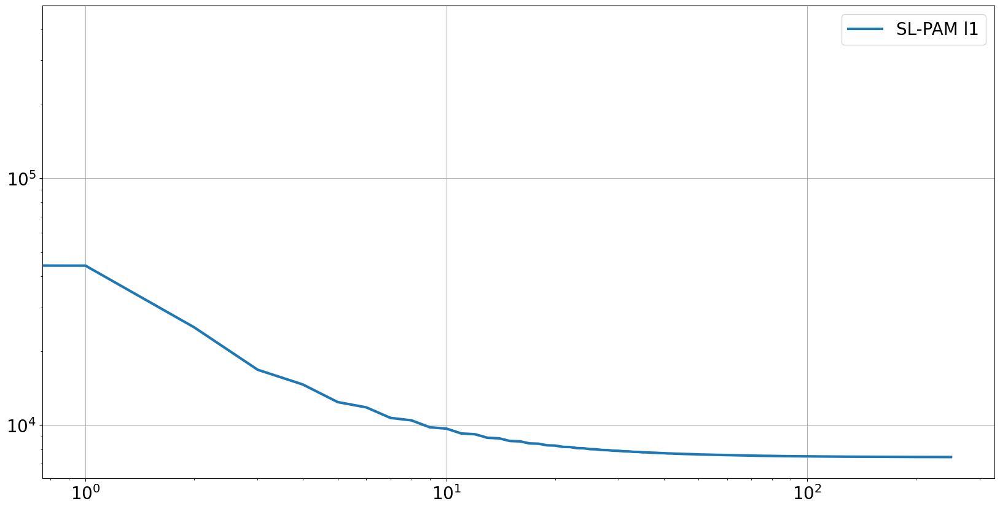

In [10]:
plt.figure(figsize=(20,10))
plt.loglog(out_slpam_l1[2], linewidth=3,label='SL-PAM l1')
plt.legend(fontsize=20)
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=20)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


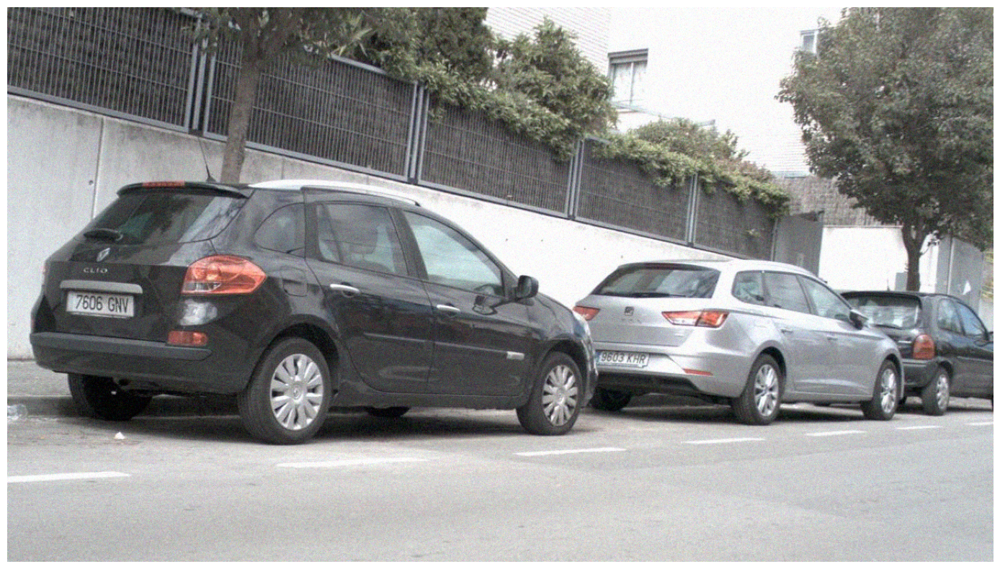

In [12]:

plt.figure(figsize=(20,10))
plt.imshow(z)
plt.axis('off')
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


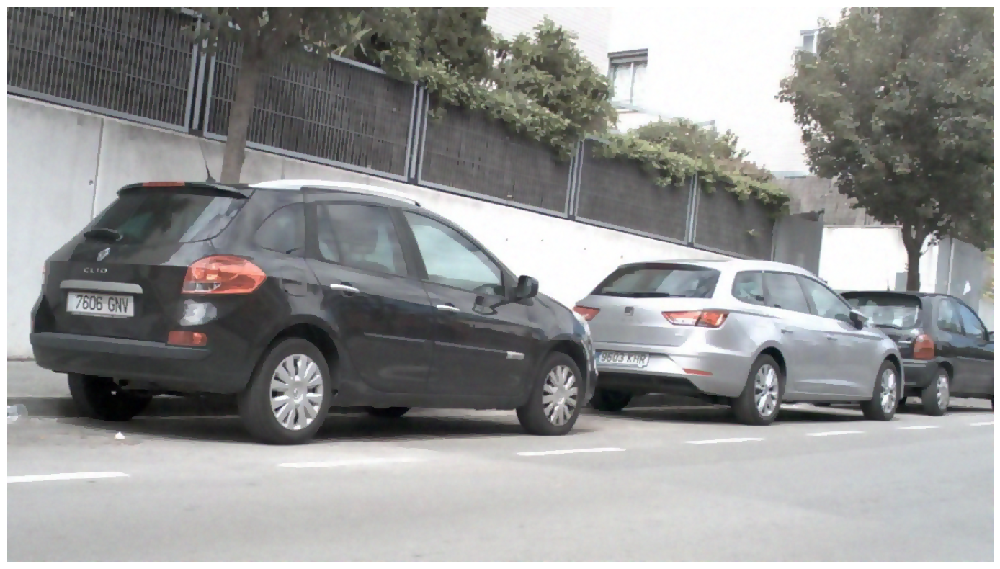

In [11]:

plt.figure(figsize=(20,10))
plt.imshow(out_slpam_l1[1])
plt.axis('off')
# plt.savefig('x_est_l1.png', bbox_inches='tight', pad_inches=0)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


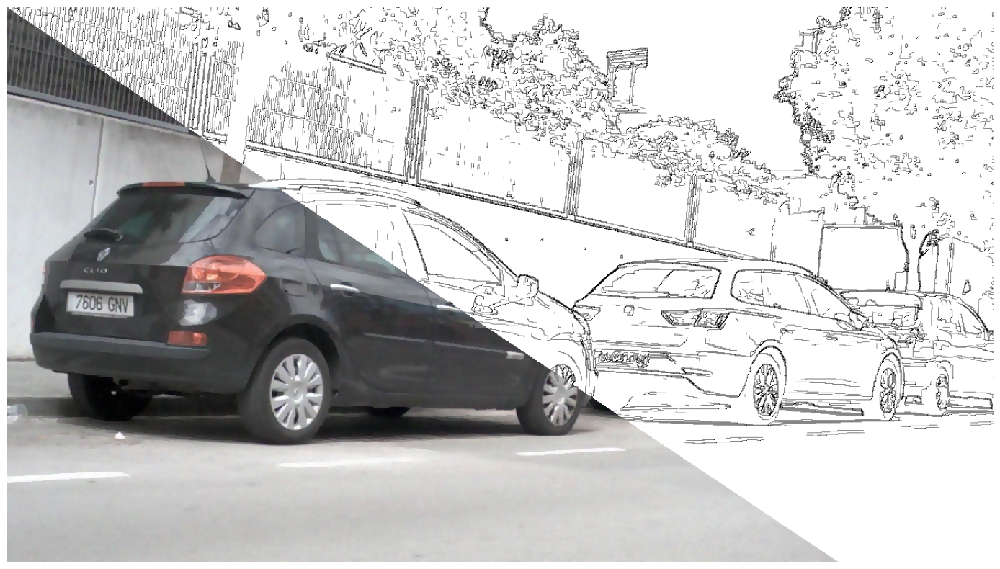

In [14]:
plt.figure(figsize=(20,10))
e1 = out_slpam_l1[0][:,:,0]+out_slpam_l1[0][:,:,1]#np.clip(out_slpam_l1[0][:,:,0]+out_slpam_at[0][:,:,1],0,1)#
x1 = out_slpam_l1[1]
x=np.copy(x1)
for i in range(rows):
    # Loop through each column
    for j in range(cols):
        # If the column index is greater than the row index, it's an element in the upper diagonal
        if j > i*(481/321):
            x[i,j,0]=1-e1[i,j]/2
            x[i,j,1]=1-e1[i,j]/2
            x[i,j,2]=1-e1[i,j]/2
plt.imshow(x)
plt.axis('off')
# plt.savefig('x_est_l1_big_lamb.png', bbox_inches='tight', pad_inches=0)
plt.show()

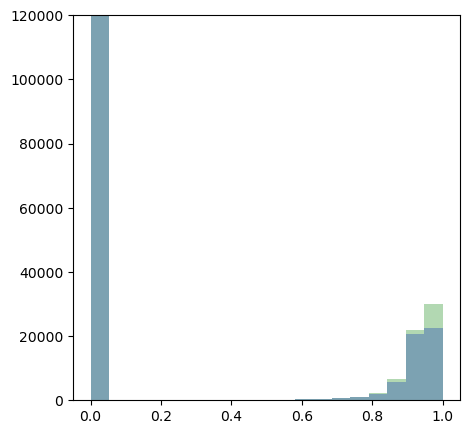

In [15]:
bins = np.linspace(0, 1, 20)
plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_l1[0][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_l1[0][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_slpam_l1_big_lamb.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

In [16]:
PSNR(original=original,compressed=out_slpam_l1[1])

32.825286634457

In [18]:
file_path = "../../../../Documents/dataset/BIPED/edges/edge_maps/train/rgbr/real/RGB_001.png"


cont = np.array(Image.open(file_path))


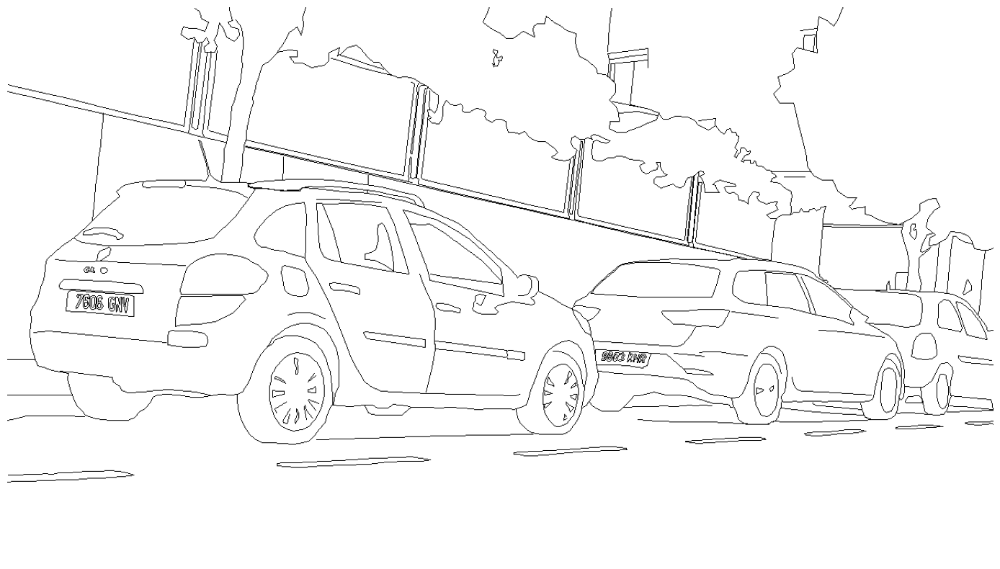

In [19]:
plt.figure(figsize=(20,10))
plt.imshow(cont,cmap='gray_r')
plt.axis('off')
plt.savefig('cont_gt_10081.png', bbox_inches='tight', pad_inches=0)
plt.show()

In [354]:
def cross_entropy(predictions, targets, epsilon=1e-12):
    """
    Computes cross entropy between targets (encoded as one-hot vectors)
    and predictions. 
    Input: predictions (N, k) ndarray
           targets (N, k) ndarray        
    Returns: scalar
    """
    predictions = np.clip(predictions, epsilon, 1. - epsilon)
    N = predictions.shape[0]
    ce = -np.sum(targets*np.log(predictions+1e-9))/N
    return ce

In [342]:
cross_entropy(predictions=est_cont,targets=cont)

170.78210190670117

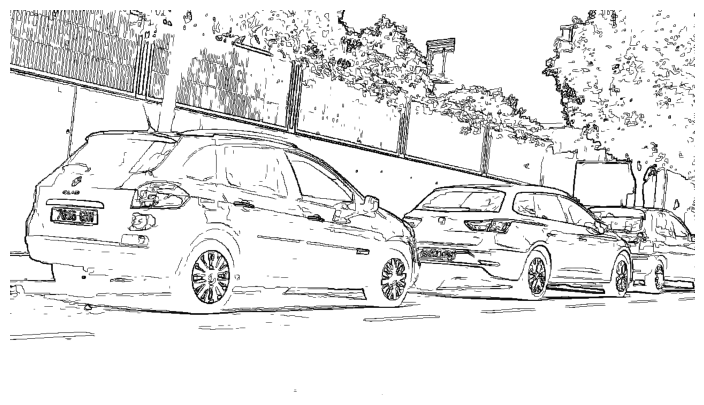

0.11736574758337155


In [22]:
est_cont= (out_slpam_l1[0][:,:,0]+out_slpam_l1[0][:,:,1])
est_cont= np.clip(out_slpam_l1[0][:,:,0]+out_slpam_l1[0][:,:,1],0,1)
plt.figure(figsize=(10,5))
plt.imshow(est_cont,cmap='gray_r')
plt.axis('off')
plt.show()
print(jaccard(est_cont,cont))


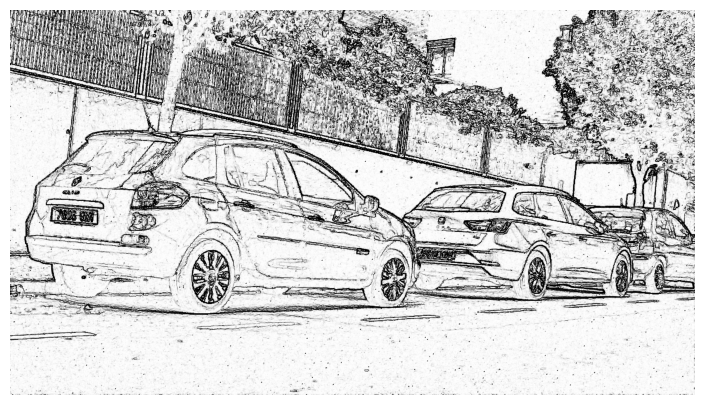

0.03026396742155685
0.030263671875


In [43]:
r=1
est_cont_at =((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1]))

est_cont_at = np.clip((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1]),0,1)

plt.figure(figsize=(10,5))
plt.imshow(est_cont_at,cmap='gray_r')
plt.axis('off')
plt.show()
print(jaccard(est_cont_at,cont))
print(jaccard((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1])/2,cont))

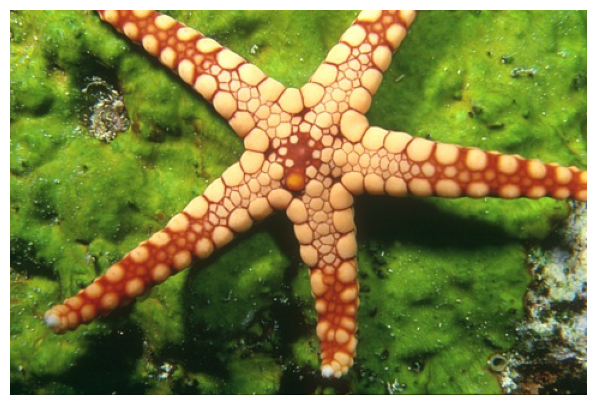

In [115]:
plt.figure(figsize=(10,5))
plt.imshow(original)
plt.axis('off')
plt.show()

In [89]:
est_cont.shape

(321, 481)

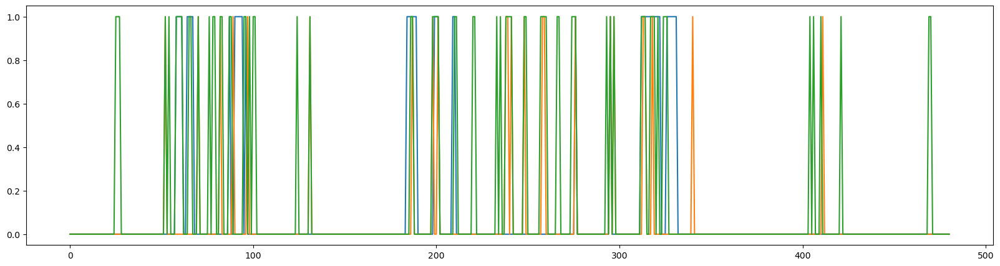

In [92]:
est_cont_at = ((out_slpam_at[4][5][:,:,0]+out_slpam_at[4][5][:,:,1]))/2
est_cont = (out_slpam_l1[0][:,:,0]+out_slpam_l1[0][:,:,1])/2
plt.figure(figsize=(20,5))
plt.plot(cont[100,:])
plt.plot(est_cont[100,:]>0.5)
plt.plot(est_cont_at[100,:]>0.5)

plt.show()


In [166]:

## Without GGS
slpam_l1_solver = DMS(
        norm_type="l1",
        edges="similar",
        beta=8,
        lamb=2e-3,
        eps=0.2,
        stop_criterion=1e-4,
        MaximumIteration=500,
        method="SLPAM",
        noised_image_input=z,
        optD="OptD",
        dk_SLPAM_factor=1e-4,
        eps_AT_min=0.02,
        A=np.ones((r,l)))

In [167]:
time1 = time.time()
out_slpam_l1 = slpam_l1_solver.process()
time_slpam_l1 = time.time()-time1

 20%|████████████▎                                                | 101/500 [00:19<01:16,  5.21it/s]


KeyboardInterrupt: 

In [ ]:
plt.figure(figsize=(20,10))
e1 = out_slpam_l1[0][:,:,0]+out_slpam_at[0][:,:,1]
x1 = out_slpam_at[1]
x=np.copy(x1)
for i in range(rows):
    # Loop through each column
    for j in range(cols):
        # If the column index is greater than the row index, it's an element in the upper diagonal
        if j > i*(481/321):
            x[i,j,0]=1-e1[i,j]/2
            x[i,j,1]=1-e1[i,j]/2
            x[i,j,2]=1-e1[i,j]/2
plt.imshow(x)
plt.axis('off')
plt.savefig('x_est_l1_small_lamb.png', bbox_inches='tight', pad_inches=0)
plt.show()

In [ ]:
bins = np.linspace(0, 1, 20)
plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_l1[0][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_l1[0][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_slpam_l1_small_lamb.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

In [ ]:
PSNR(original=original,compressed=out_slpam_at[1])

In [ ]:
est_cont =(out_slpam_l1[0][:,:,0]+out_slpam_at[0][:,:,1])/2
ssim(cont,est_cont)

In [44]:

## Without GGS
slpam_at_solver = DMS(
        norm_type="AT",
        edges="similar",
        beta=2,
        lamb=1e-3,
        eps=0.2,
        stop_criterion=1e-4,
        MaximumIteration=150,
        method="SLPAM-eps-descent",
        noised_image_input=z,
        optD="OptD",
        dk_SLPAM_factor=1e-4,
        eps_AT_min=0.1,
        A=np.ones((rows,cols)))
palm_at_solver = DMS(
        norm_type="AT",
        edges="similar",
        beta=8,
        lamb=7e-2,
        eps=0.2,
        stop_criterion=1e-4,
        MaximumIteration=500,
        method="PALM-eps-descent",
        noised_image_input=z,
        optD="OptD",
        eps_AT_min=0.02,
        A=np.ones((rows,cols)))



In [45]:
time1 = time.time()
out_slpam_at = slpam_at_solver.process()
time_slpam_at = time.time()-time1

0.2
0.16666666666666669
0.13888888888888892
0.11574074074074077


In [6]:
time2 = time.time()
out_palm_at = palm_at_solver.process()
time_palm_at= time.time()-time2

Epsilon:  0.2
Epsilon:  0.13333333333333333
Epsilon:  0.08888888888888889
Epsilon:  0.05925925925925926
Epsilon:  0.03950617283950617
Epsilon:  0.02633744855967078


In [7]:
print("SLPAM-CT:",time_slpam_at)
print("PALM-CT:",time_palm_at)

SLPAM-CT: 2233.0079827308655
PALM-CT: 751.5357370376587


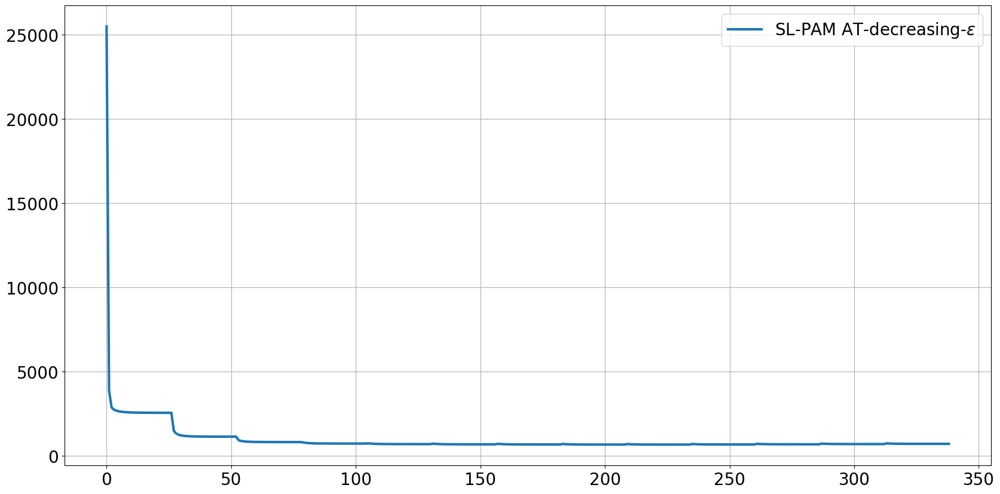

In [25]:
plt.figure(figsize=(20,10))
# plt.loglog(out_slpam_at[2], linewidth=3,label='SL-PAM AT-decreasing-$\epsilon$')
plt.plot(out_slpam_at[2], linewidth=3,label='SL-PAM AT-decreasing-$\epsilon$')

# plt.loglog(out_palm_at[2], linewidth=3,label='PALM AT-decreasing-$\epsilon$')
plt.legend(fontsize=20)
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=20)
plt.savefig('crit_dms_at_compare_decreasing_eps.png', bbox_inches='tight', pad_inches=0)


In [26]:
round,_,_,_=np.shape(out_slpam_at[4])

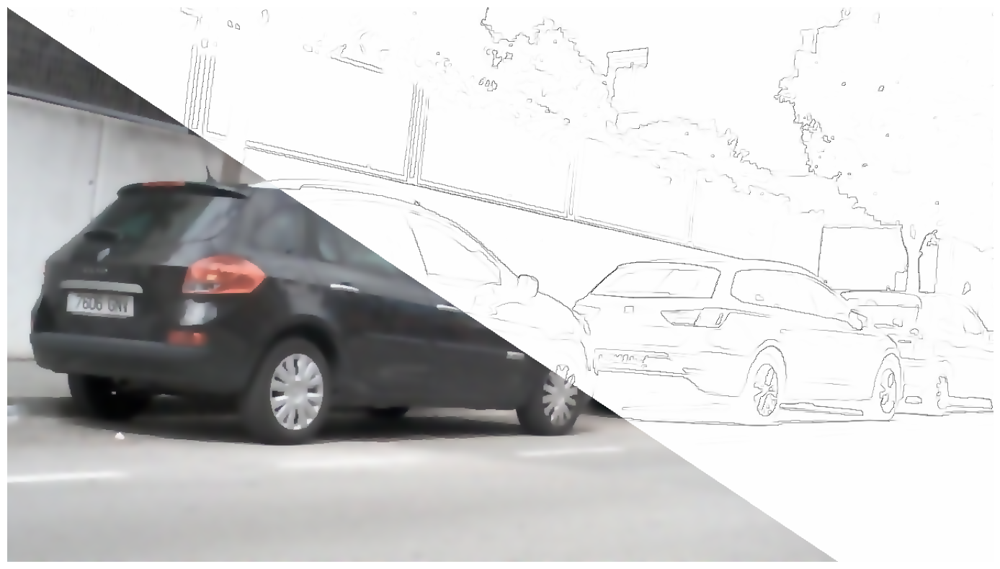

In [27]:
plt.figure(figsize=(20,10))
e1 = out_slpam_at[4][round-1][:,:,0]+out_slpam_at[4][round-1][:,:,1]
x1 = out_slpam_at[3][round-1]
x=np.copy(x1)
for i in range(rows):
    # Loop through each column
    for j in range(cols):
        # If the column index is greater than the row index, it's an element in the upper diagonal
        if j > i*(481/321):
            x[i,j,0]=1-e1[i,j]/2
            x[i,j,1]=1-e1[i,j]/2
            x[i,j,2]=1-e1[i,j]/2
plt.imshow(x)
plt.axis('off')
plt.savefig('x_est_eps_0.png', bbox_inches='tight', pad_inches=0)
plt.show()


In [28]:
est_cont = (out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1])/2
print(np.mean((est_cont - cont) ** 2))
ssim(est_cont,cont,data_range=1)

1960.4276268944457


0.00035062723811767895

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


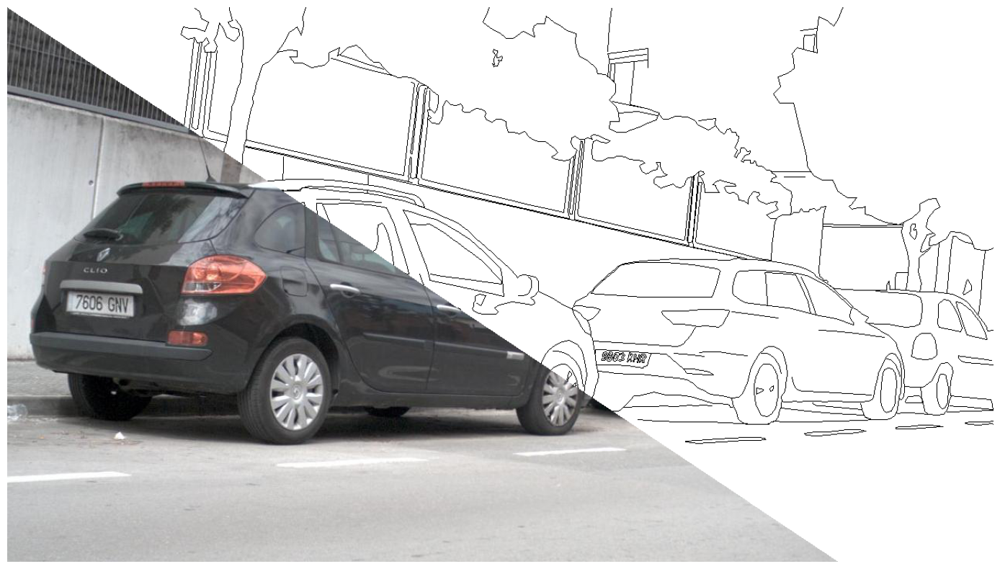

In [29]:
plt.figure(figsize=(20,10))
e1 = cont
x1 =original
x=np.copy(x1)
for i in range(rows):
    # Loop through each column
    for j in range(cols):
        # If the column index is greater than the row index, it's an element in the upper diagonal
        if j > i*(481/321):
            x[i,j,0]=1-e1[i,j]/2
            x[i,j,1]=1-e1[i,j]/2
            x[i,j,2]=1-e1[i,j]/2
plt.imshow(x)
plt.axis('off')
plt.savefig('x_cont.png', bbox_inches='tight', pad_inches=0)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


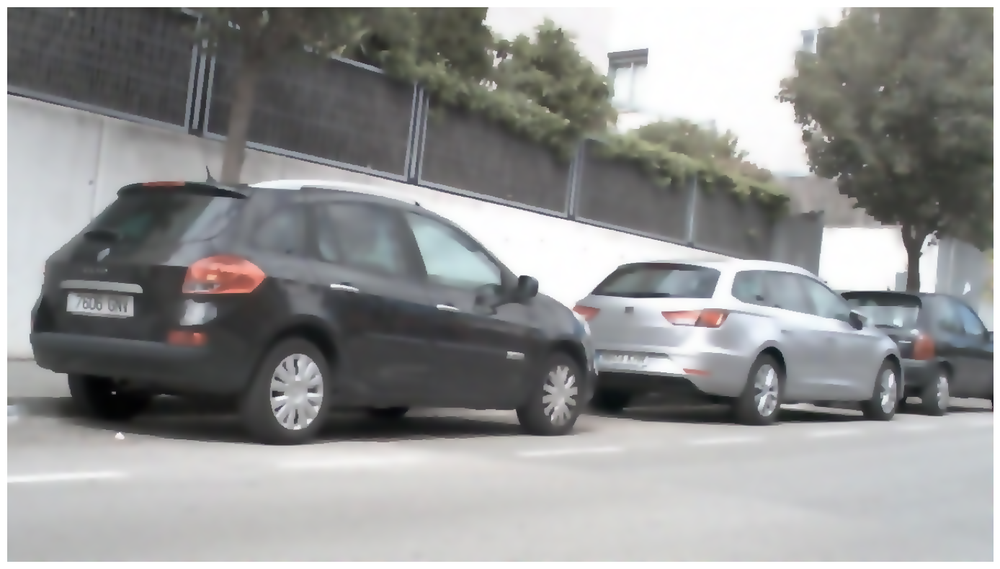

In [30]:

plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[1])
plt.axis('off')
plt.savefig('x_est_at_decreasing.png', bbox_inches='tight', pad_inches=0)
plt.show()


In [31]:
print(jaccard(np.zeros_like(cont),cont))

0.0


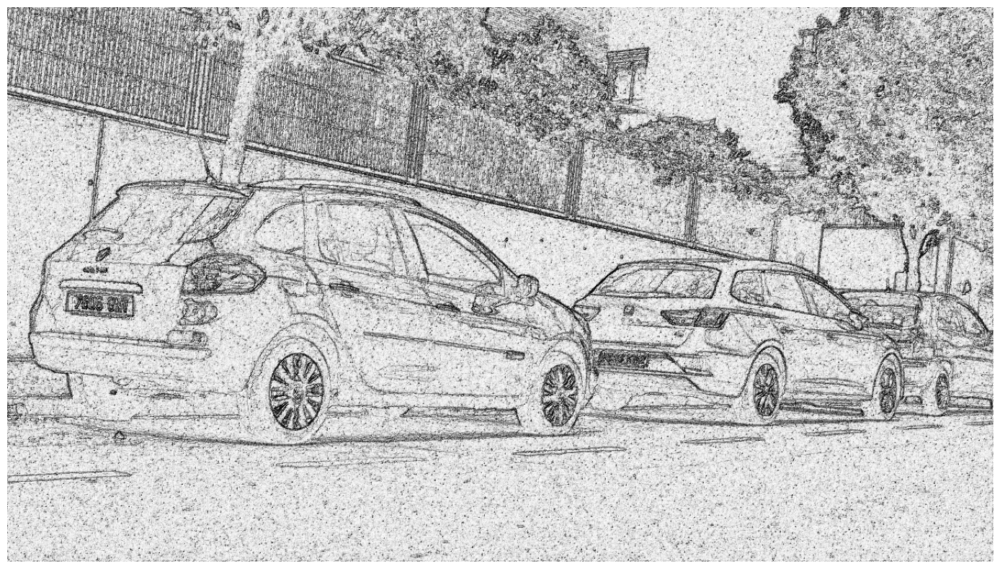

0.09178902792664242


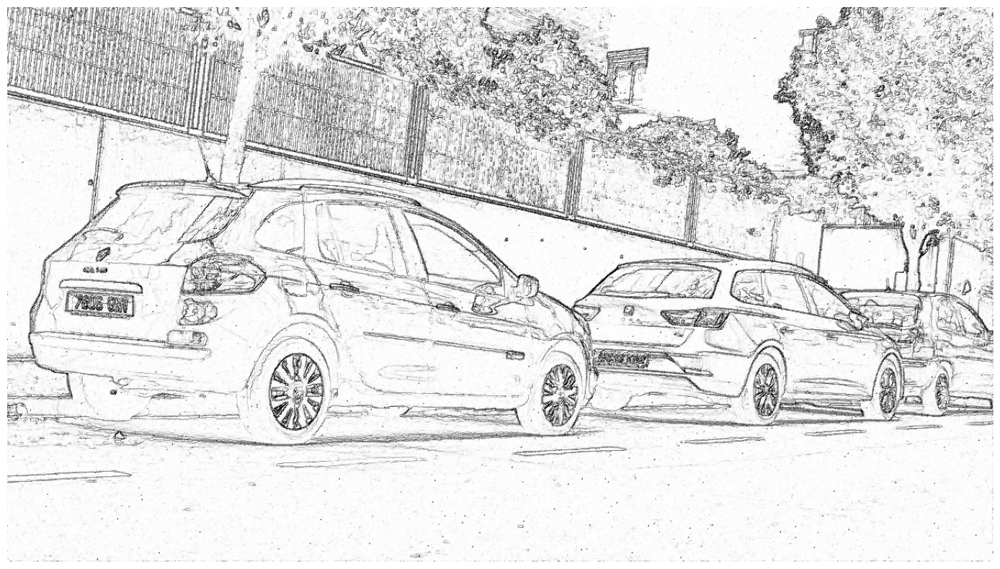

0.10048178055235123


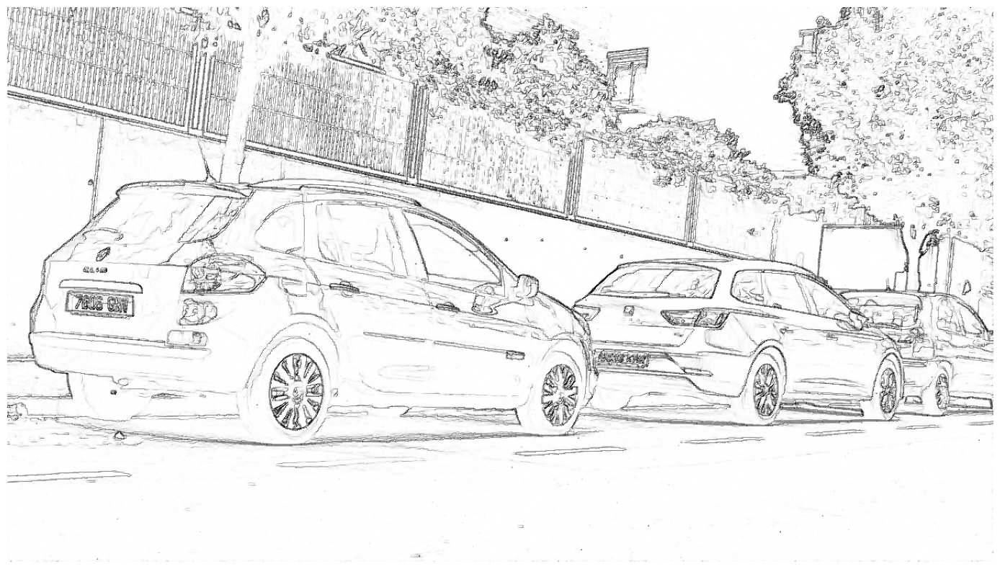

0.08878061727458861


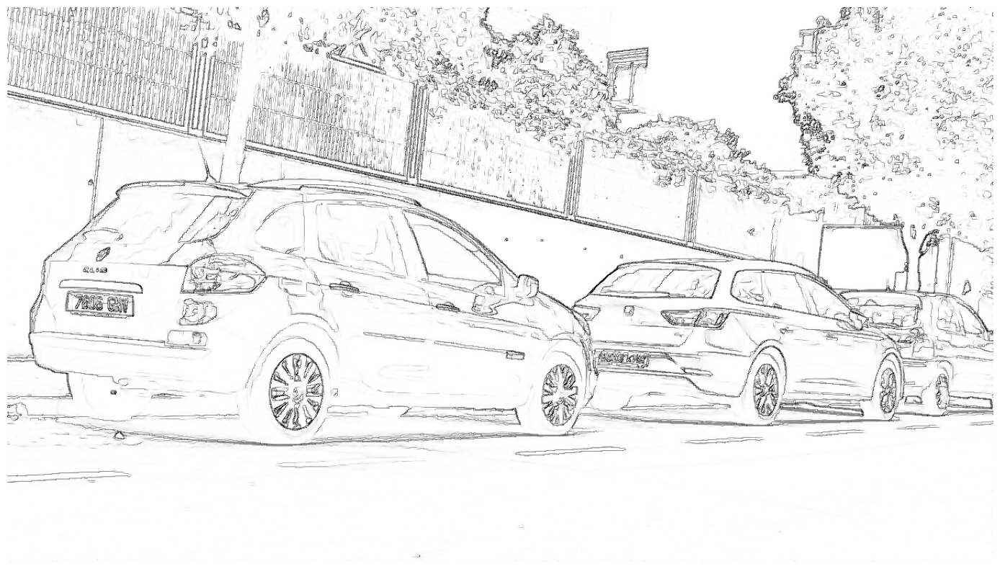

0.07398139090474783


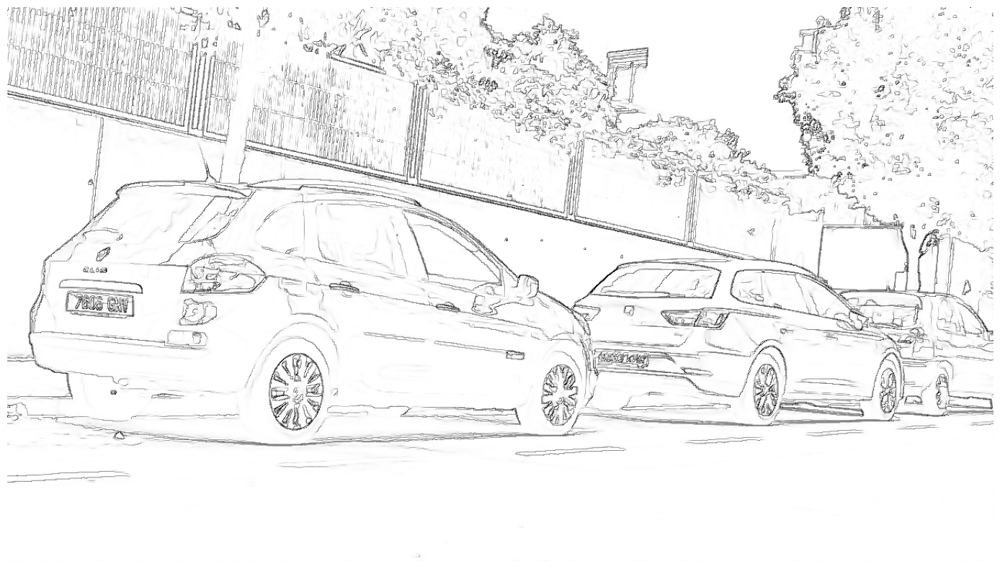

0.06154710524299614


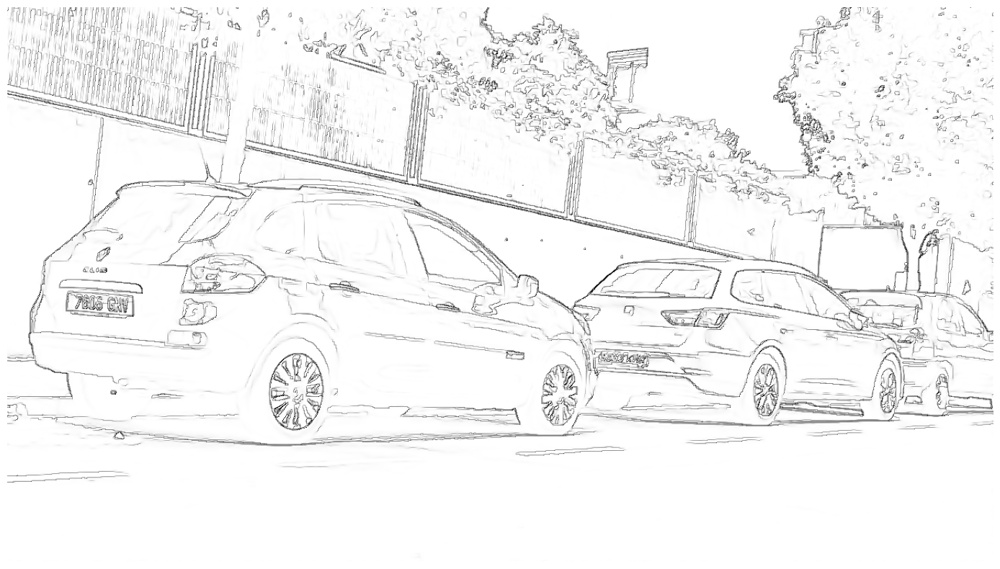

0.051715509091920145


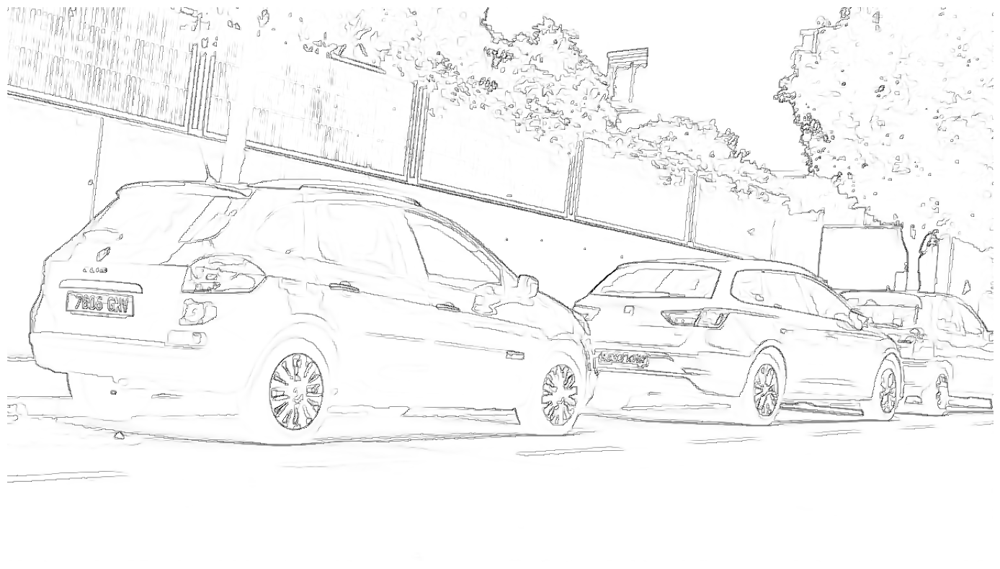

0.04242388482416804


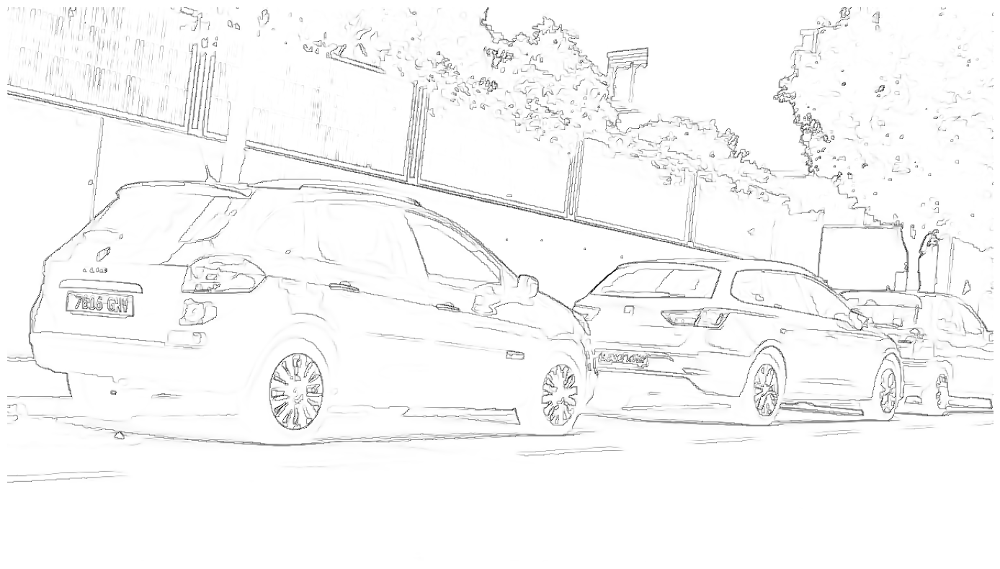

0.03486142044048503


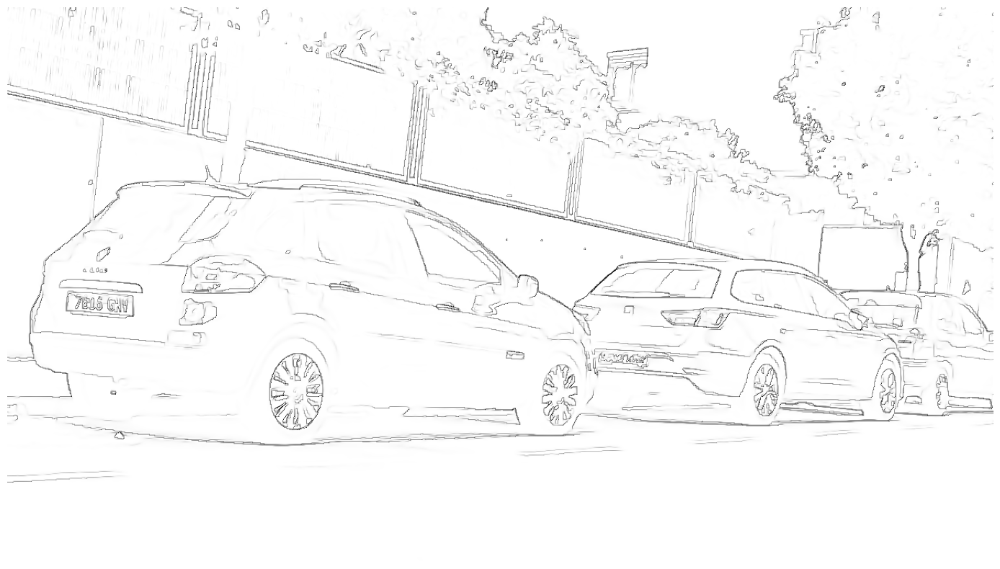

0.02737839828364661


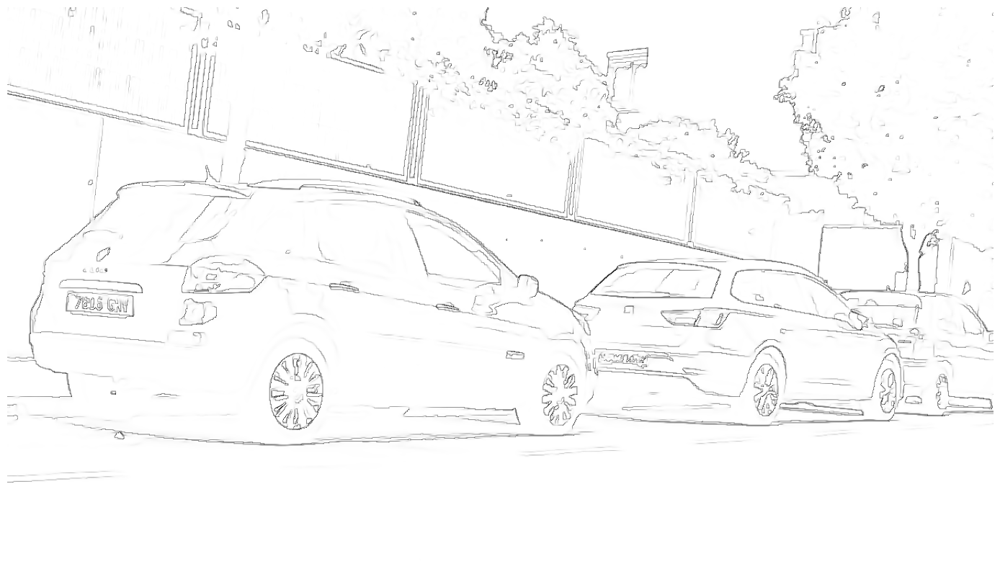

0.022760163136429416


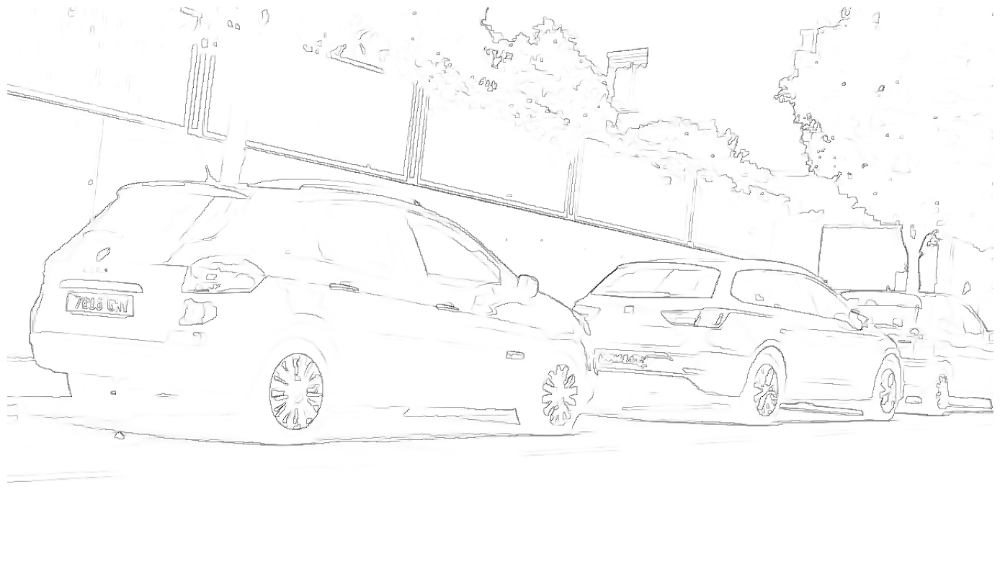

0.018627286457459306


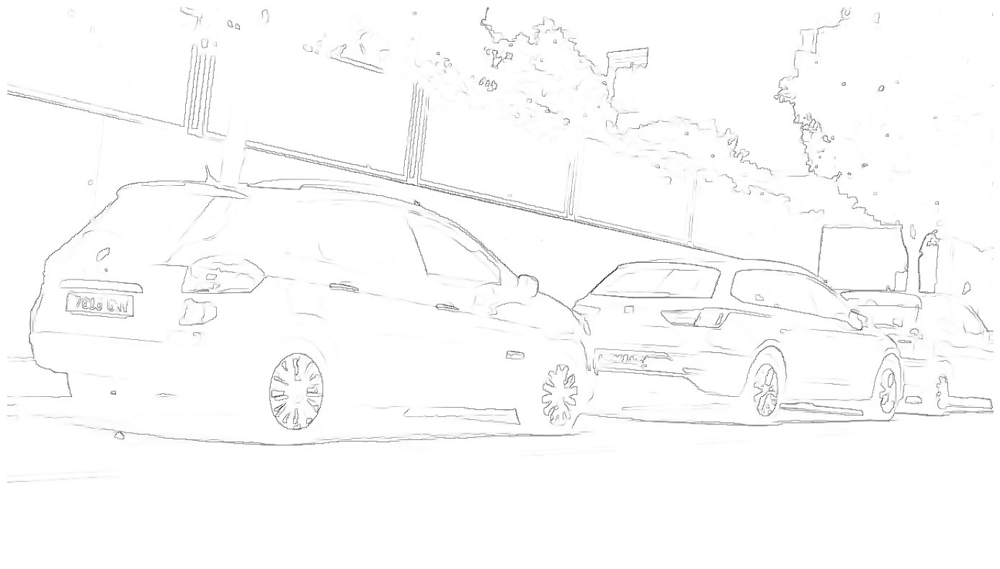

0.014408338442673207


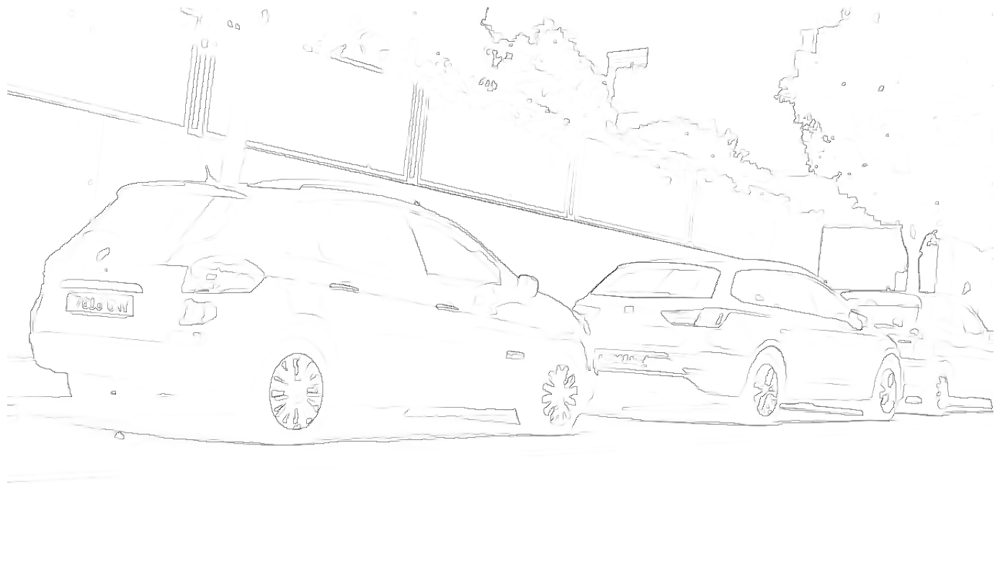

0.01152916810493614


In [32]:
for r in range(round):
    plt.figure(figsize=(20,10))
    plt.imshow(out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1],cmap='gray_r')
    plt.axis('off')
#     plt.savefig('e_eps_'+str(r)+'.png', bbox_inches='tight', pad_inches=0)
    plt.show()
#     print(ssim((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1])/2>0.5,cont,data_range=1))
    print(jaccard((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1])/2>0.5,cont))




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


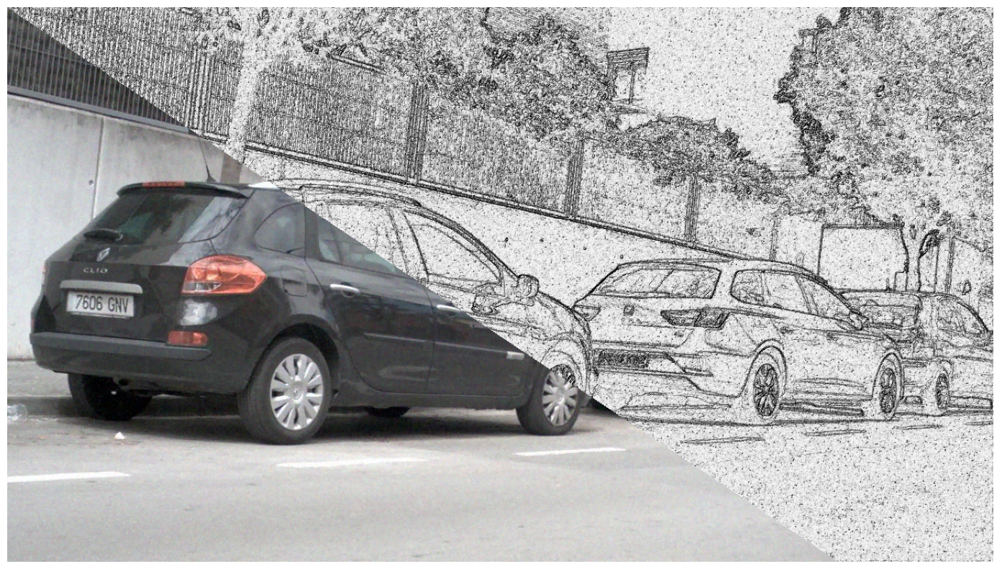

33.11229781530632
0.00035062723811767895
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


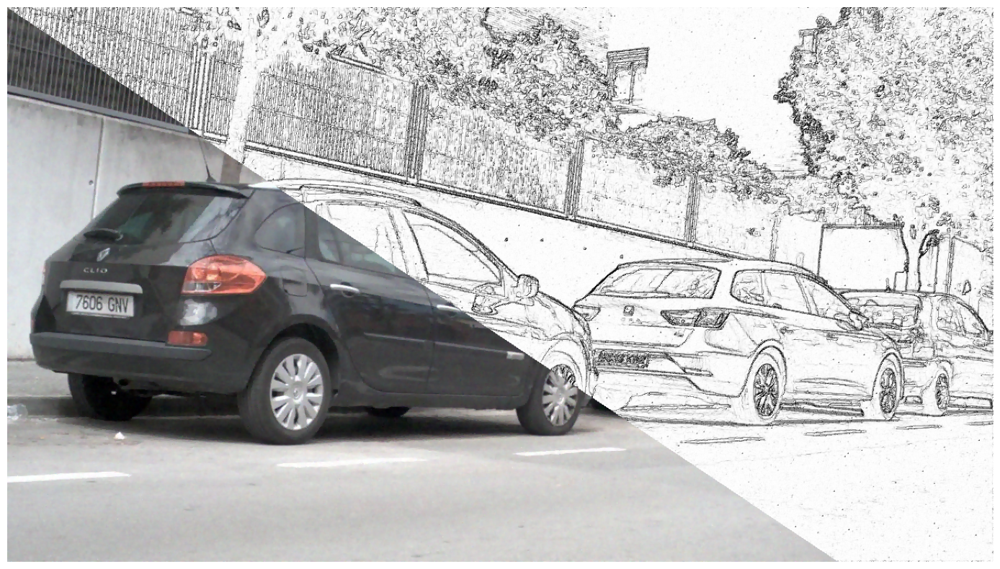

34.80482787436355
0.10565309230156425
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


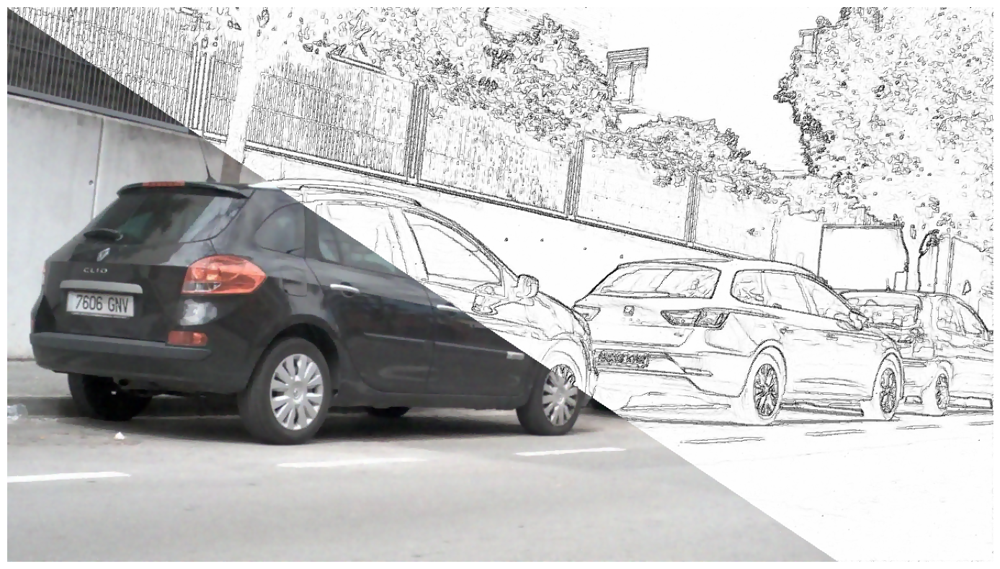

34.16915329966196
0.34368650048687993
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


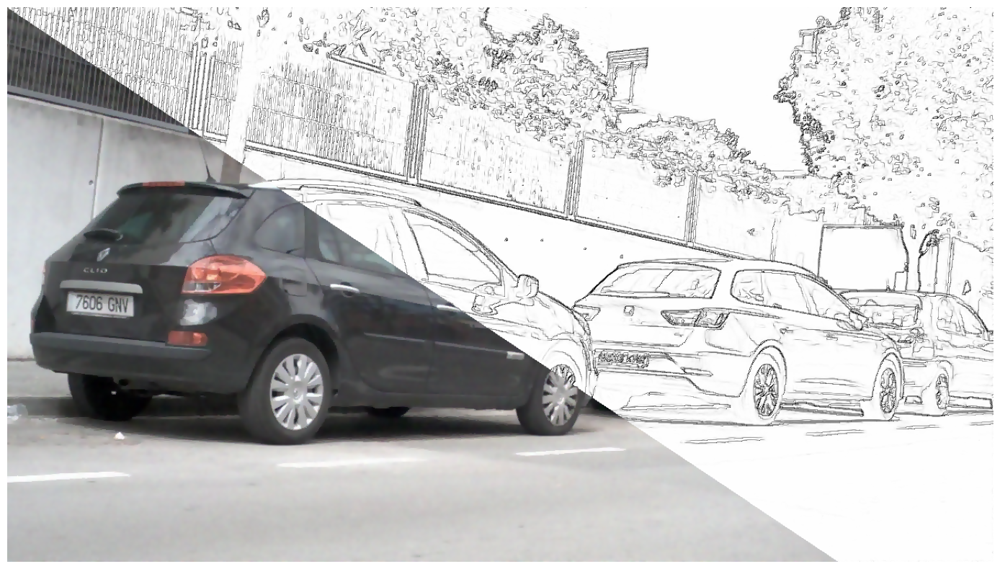

33.15127417542075
0.4258513241799524
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


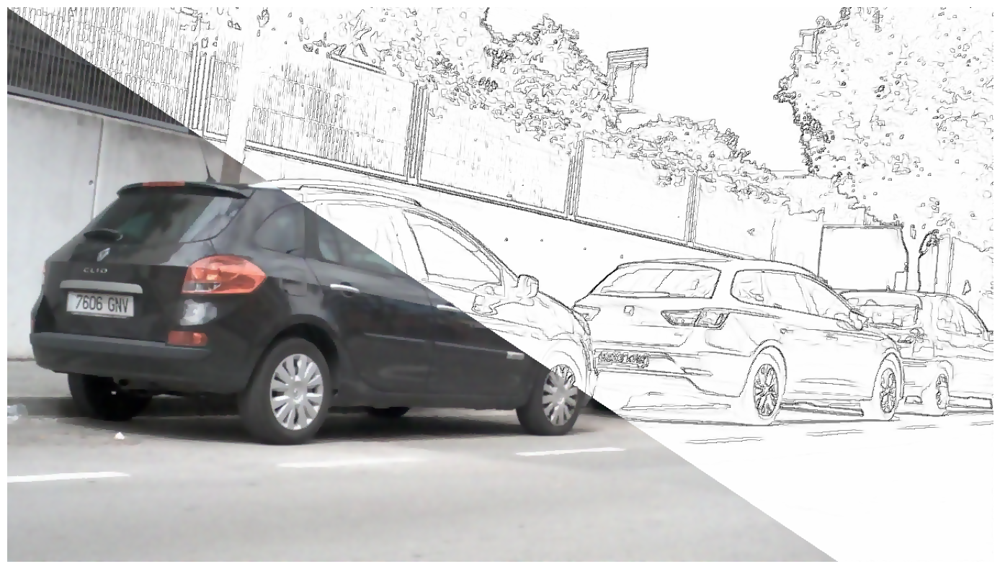

32.19911373519138
0.47514392174694114
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


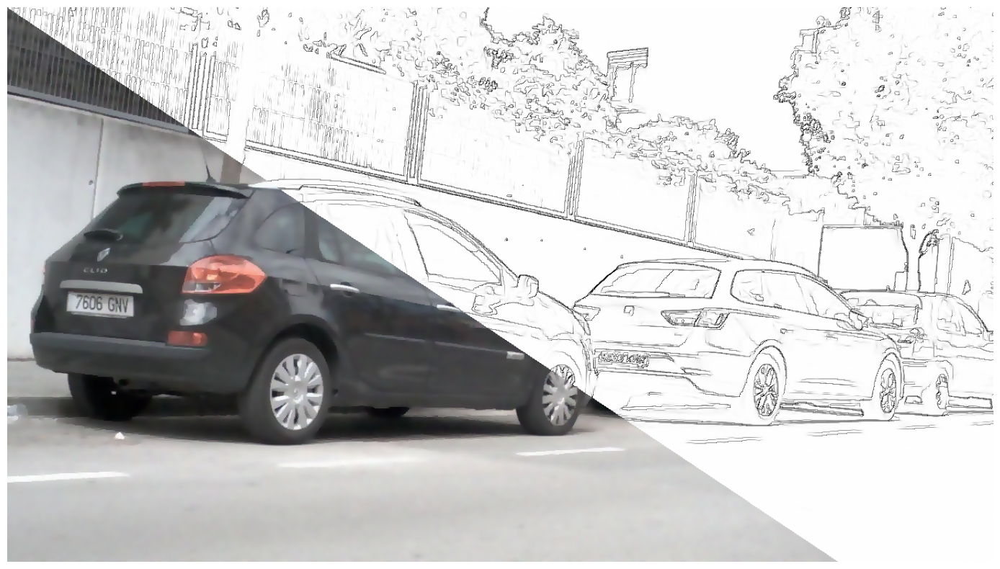

31.353342731461467
0.516252345331723
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


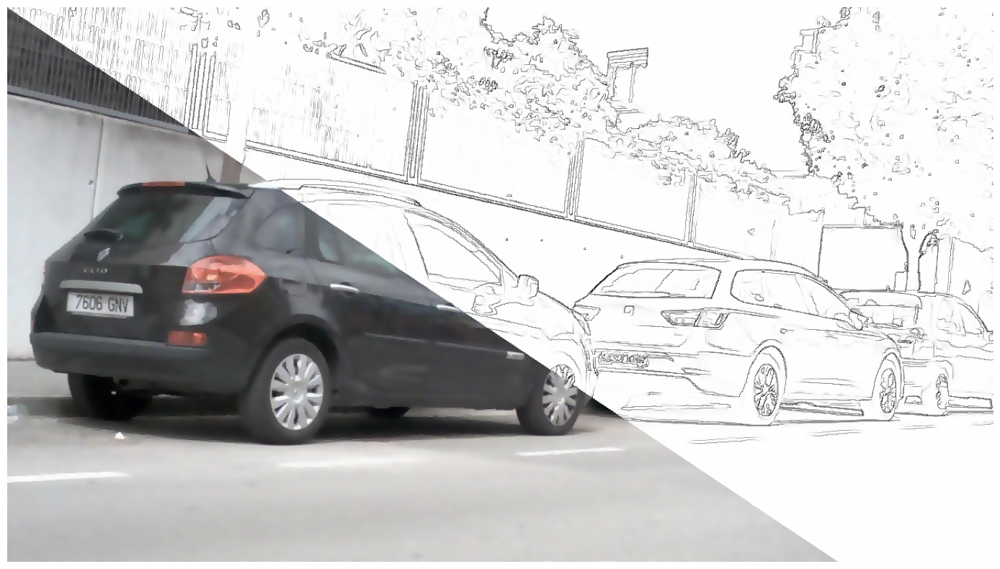

30.59944793645436
0.5537884682605356
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


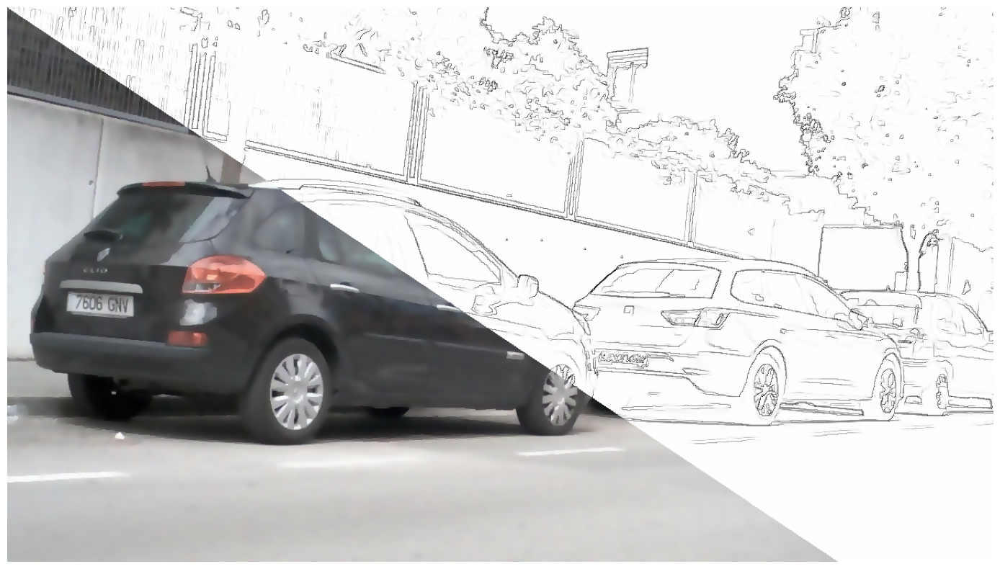

29.931881032088178
0.5907420258743938
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


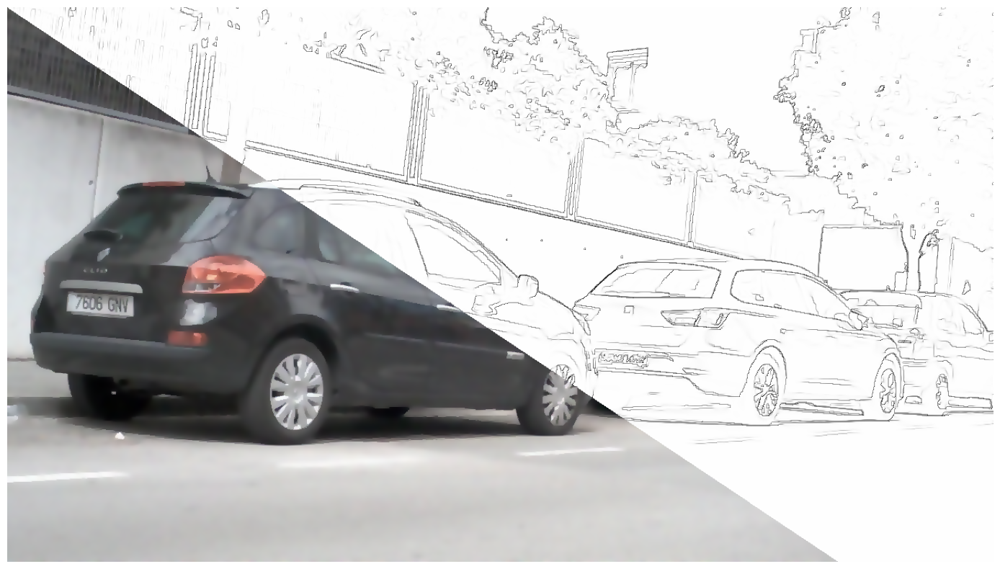

29.352115456960846
0.6257721665147598
0.030263671875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


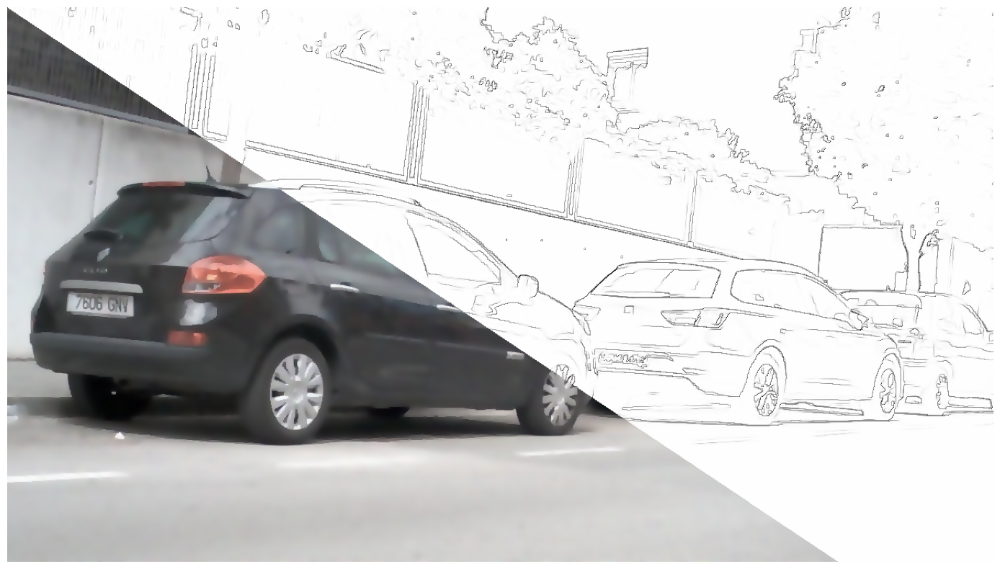

28.84807024870892
0.6550304232440599
0.030263671875


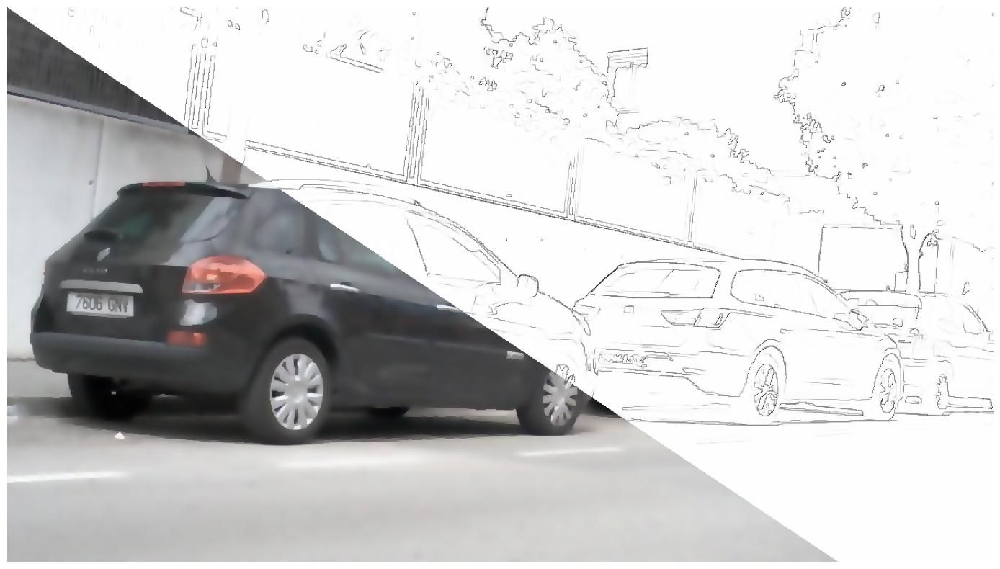

28.39893928212706
0.6771330582435761
0.030263671875


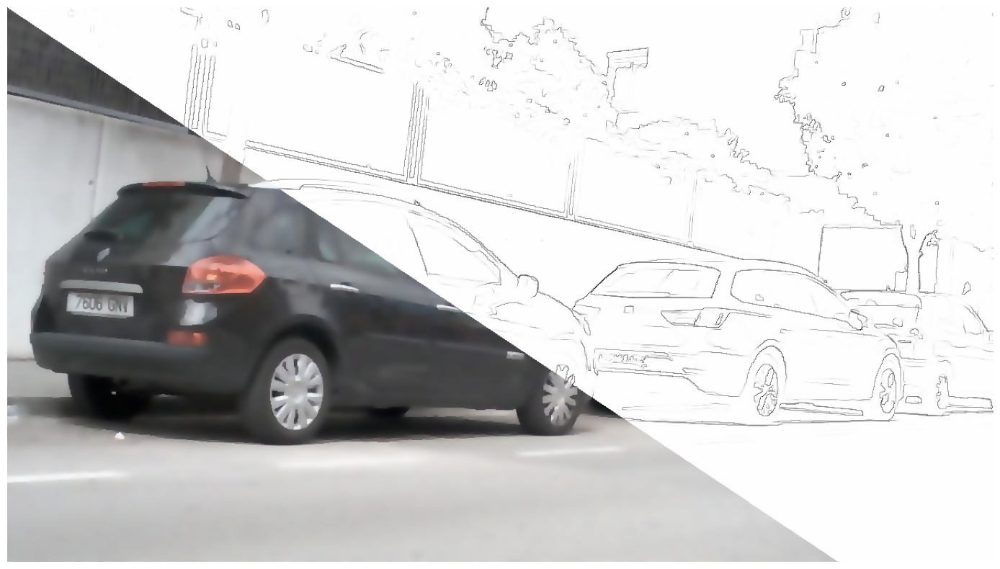

27.988531542835688
0.694523319621174
0.030263671875


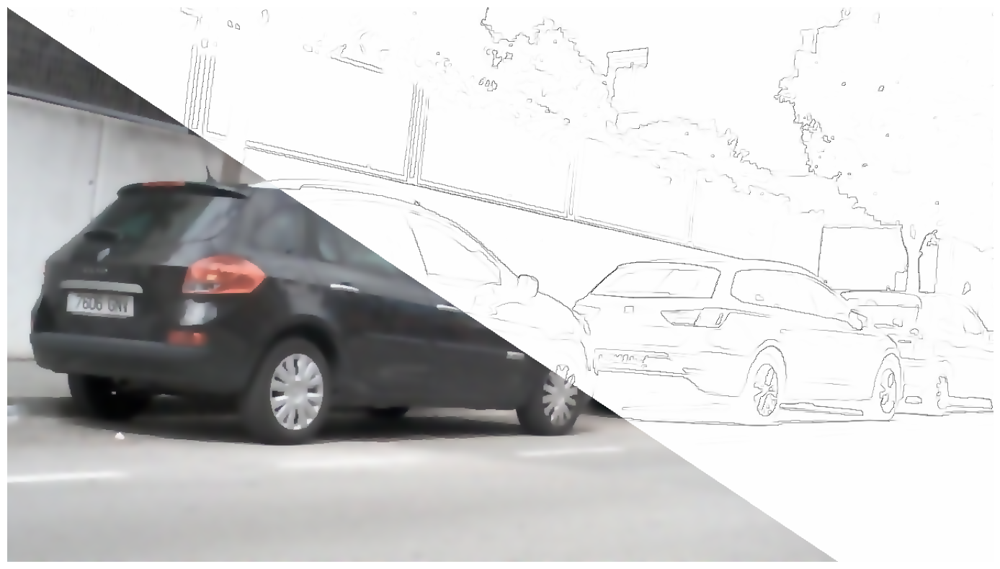

27.605980516044625
0.7090752127381724
0.030263671875


In [33]:
for r in range(round):
    plt.figure(figsize=(20,10))
    e1 = out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1]
    x1 = out_slpam_at[3][r]
    x=np.copy(x1)
    for i in range(rows):
        # Loop through each column
        for j in range(cols):
            # If the column index is greater than the row index, it's an element in the upper diagonal
            if j > i*(481/321):
                x[i,j,0]=1-e1[i,j]/2
                x[i,j,1]=1-e1[i,j]/2
                x[i,j,2]=1-e1[i,j]/2
    plt.imshow(x)
    plt.axis('off')
#     plt.savefig('x_est_eps_'+str(r)+'.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    print(PSNR(original,x1))
    print(ssim((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1])/2,cont,data_range=1))
    print(jaccard((out_slpam_at[4][r][:,:,0]+out_slpam_at[4][r][:,:,1])/2,cont))


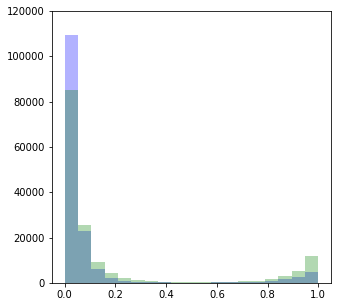

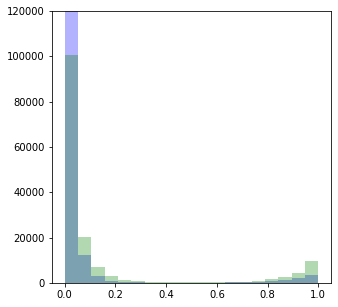

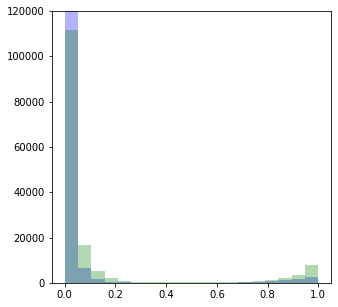

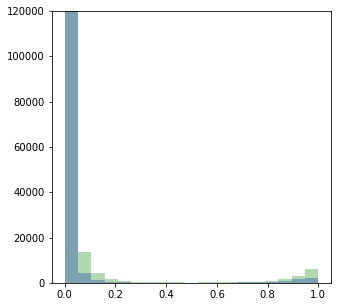

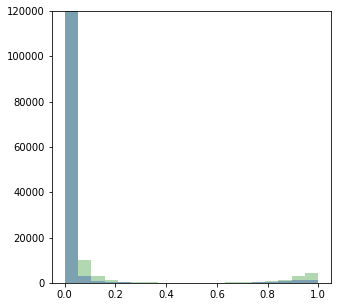

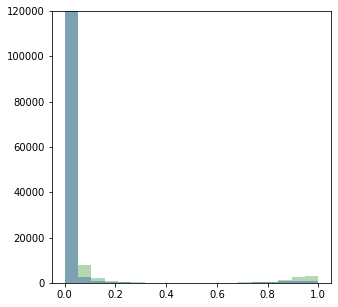

In [16]:
bins = np.linspace(0, 1, 20)
plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_at[4][0][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_at[4][0][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_eps_0.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_at[4][1][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_at[4][1][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_eps_1.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_at[4][2][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_at[4][2][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_eps_2.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_at[4][3][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_at[4][3][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_eps_3.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_at[4][4][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_at[4][4][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_eps_4.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()

plt.figure(figsize=(5,5))
# e1 = out_slpam_at[4][0][:,:,0]+out_slpam_at[4][0][:,:,1]
# plt.hist(e1.flatten()/2)
plt.hist(out_slpam_at[4][5][:,:,0].flatten(),bins,alpha=0.3,color='blue')
plt.hist(out_slpam_at[4][5][:,:,1].flatten(),bins,alpha=0.3,color='green')
plt.savefig('hist_est_eps_5.png', bbox_inches='tight', pad_inches=0)
plt.ylim(0,120000)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


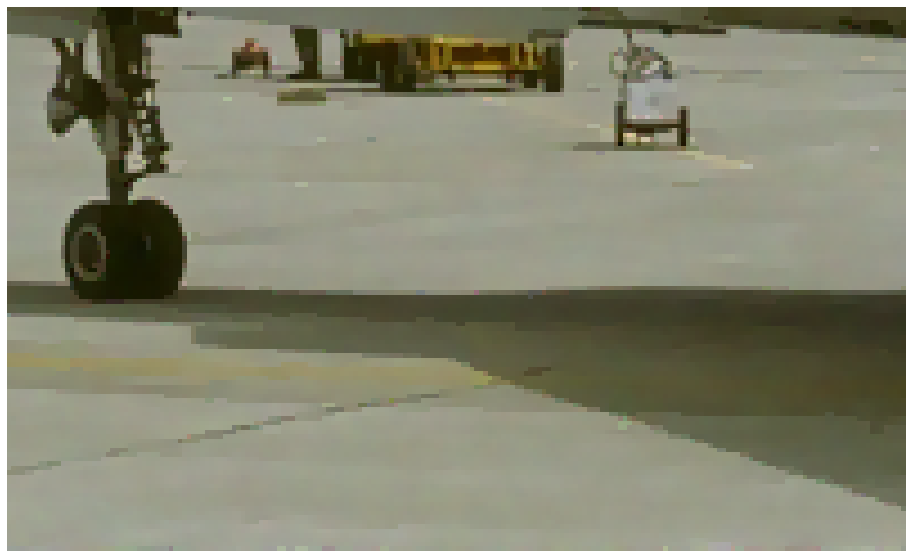

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


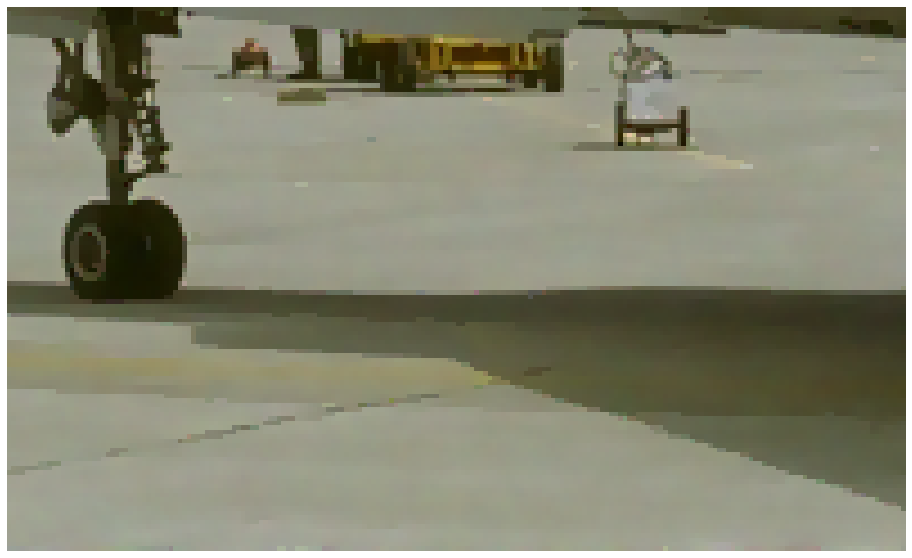

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


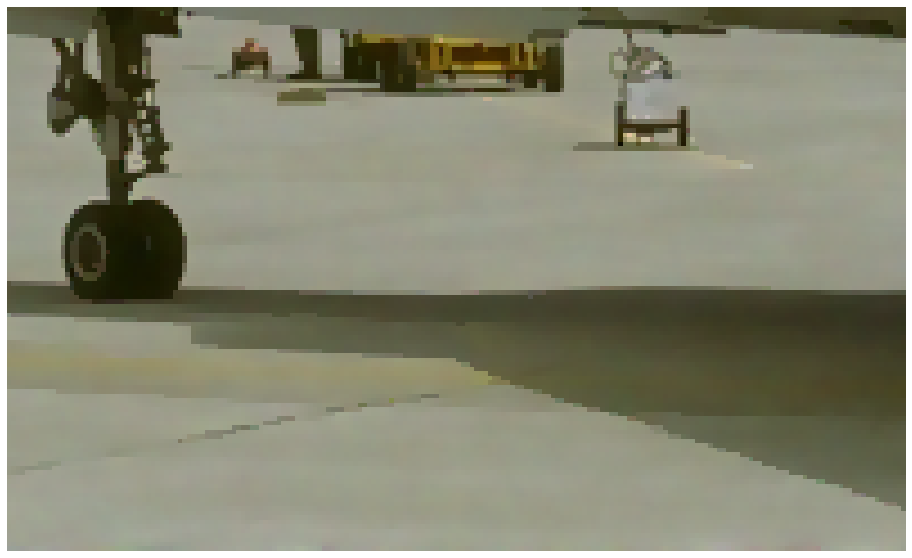

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


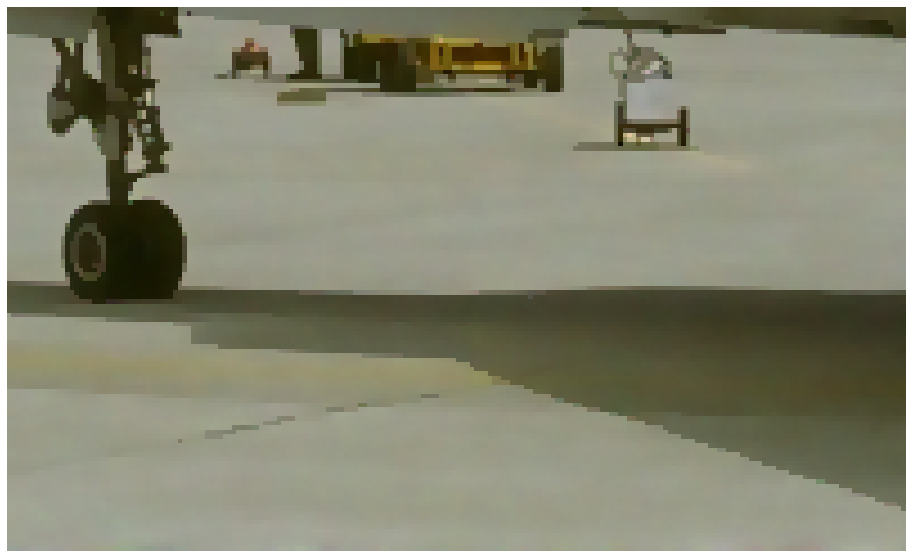

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


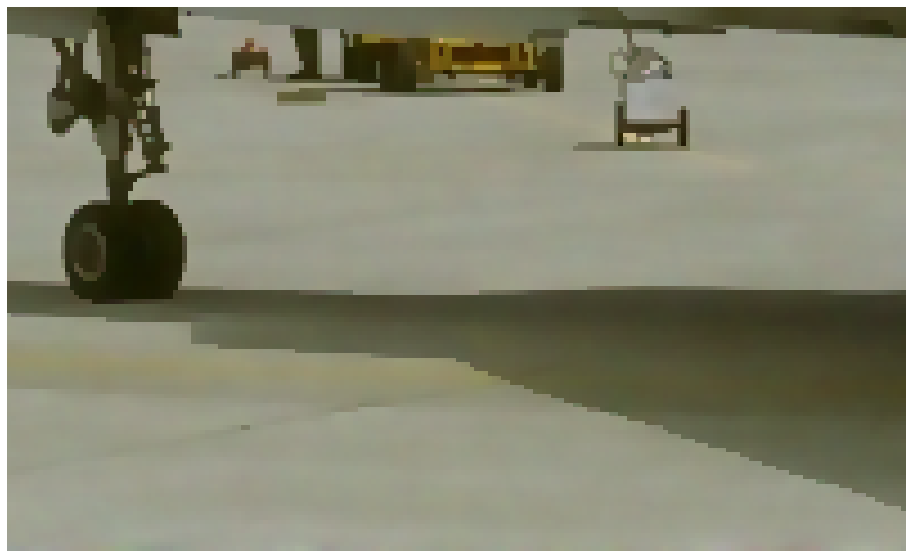

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


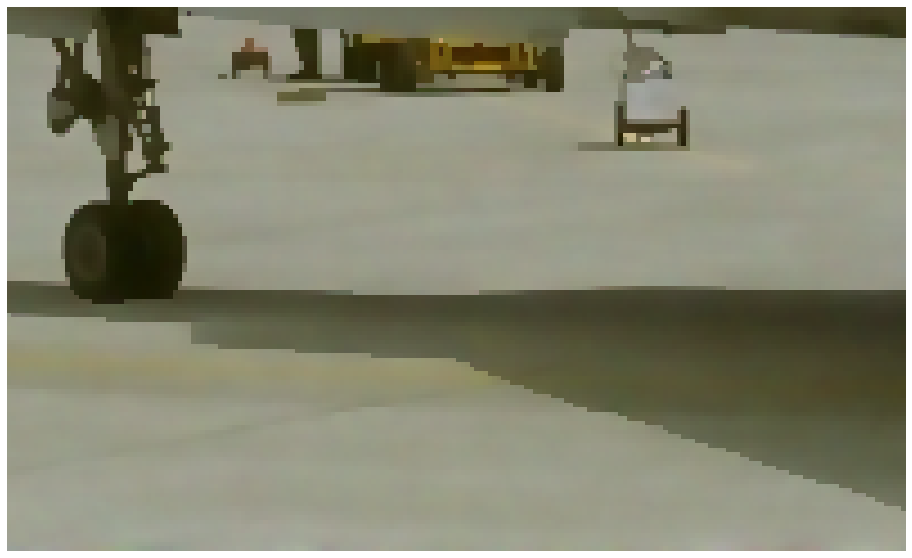

In [17]:
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[3][0][200:400,200:400,:])
plt.axis('off')
plt.savefig('zoom_x_est_eps_0.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[3][1][200:400,200:400,:])
plt.axis('off')
plt.savefig('zoom_x_est_eps_1.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[3][2][200:400,200:400,:])
plt.axis('off')
plt.savefig('zoom_x_est_eps_2.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[3][3][200:400,200:400,:])
plt.axis('off')
plt.savefig('zoom_x_est_eps_3.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[3][4][200:400,200:400,:])
plt.axis('off')
plt.savefig('zoom_x_est_eps_4.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[3][5][200:400,200:400,:])
plt.axis('off')
plt.savefig('zoom_x_est_eps_5.png', bbox_inches='tight', pad_inches=0)
plt.show()

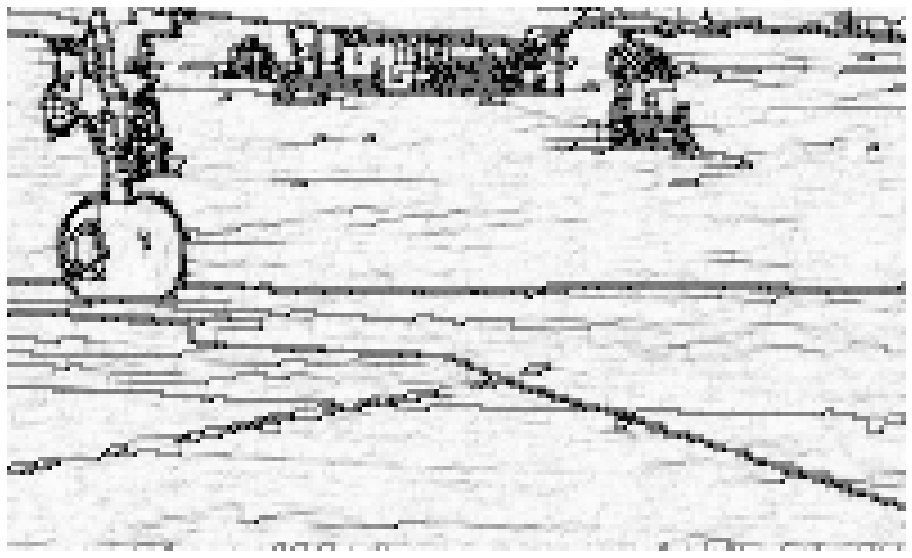

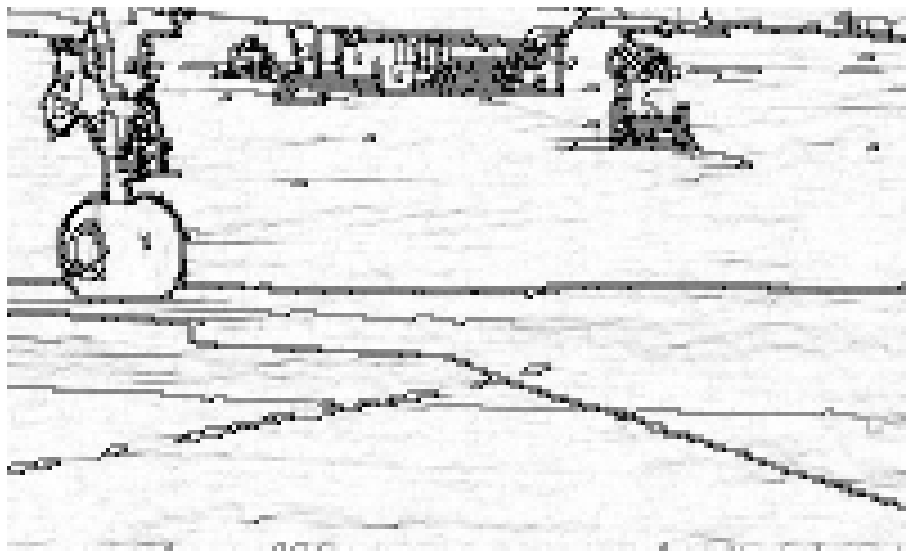

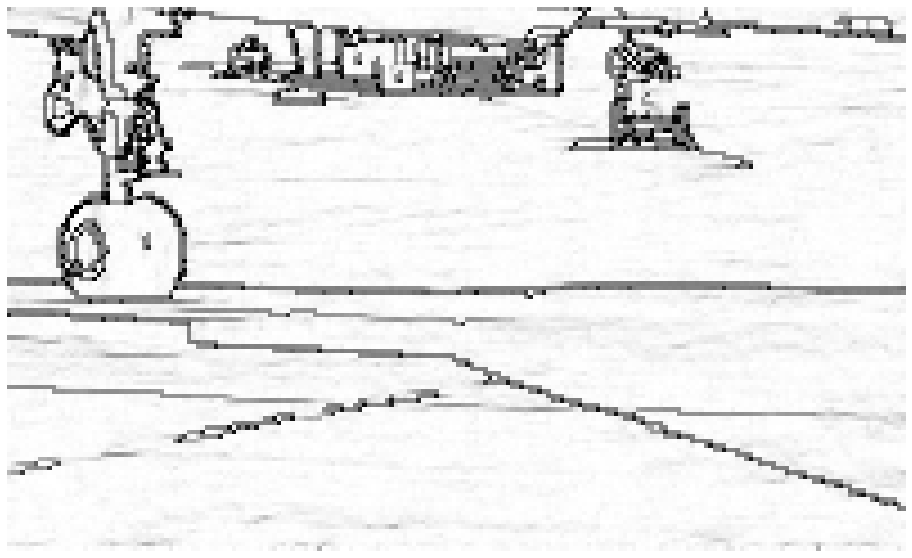

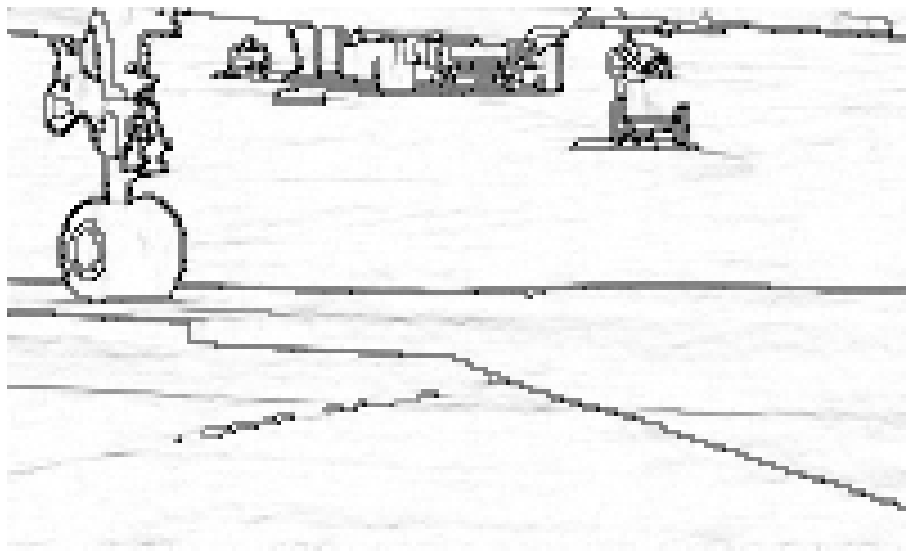

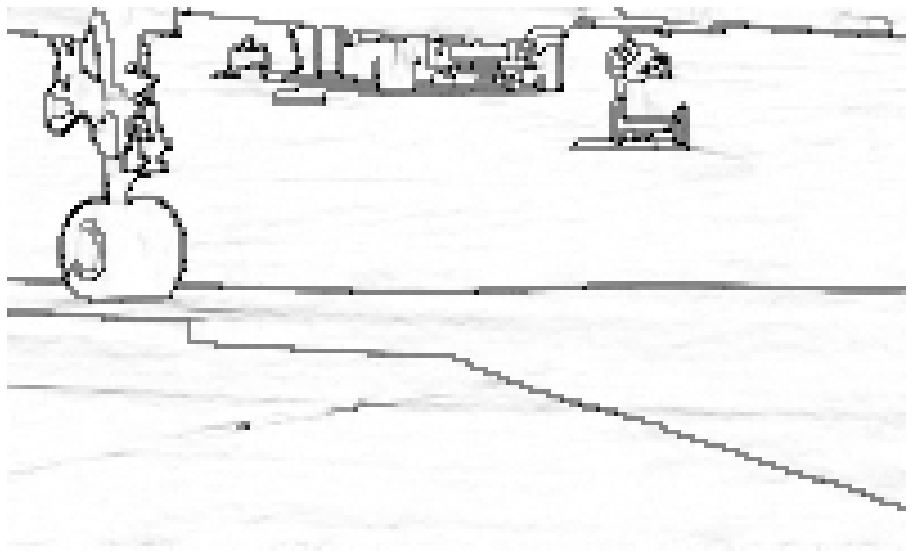

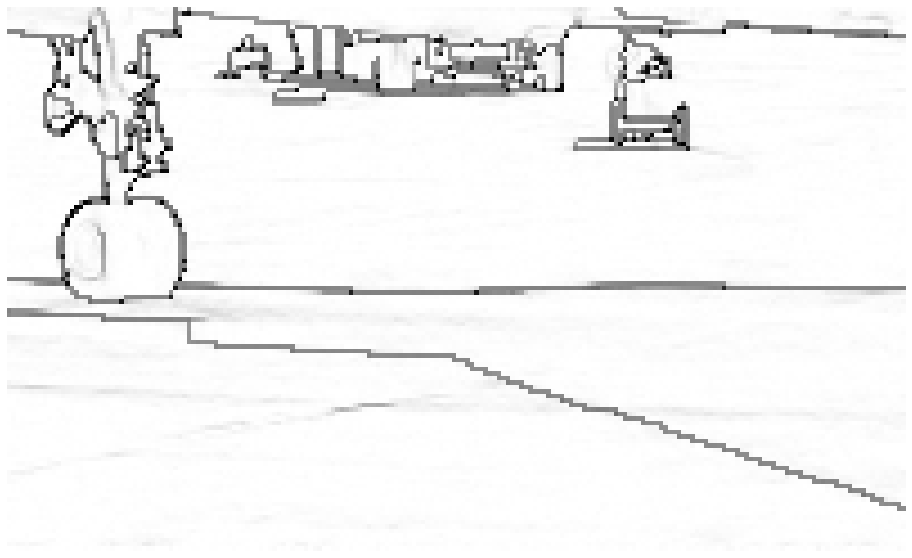

In [18]:
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[4][0][200:400,200:400,0]+out_slpam_at[4][0][200:400,200:400,1],cmap='gray_r')
plt.axis('off')
plt.savefig('zoom_e_eps_0.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[4][1][200:400,200:400,0]+out_slpam_at[4][1][200:400,200:400,1],cmap='gray_r')
plt.axis('off')
plt.savefig('zoom_e_eps_1.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[4][2][200:400,200:400,0]+out_slpam_at[4][2][200:400,200:400,1],cmap='gray_r')
plt.axis('off')
plt.savefig('zoom_e_eps_2.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[4][3][200:400,200:400,0]+out_slpam_at[4][3][200:400,200:400,1],cmap='gray_r')
plt.axis('off')
plt.savefig('zoom_e_eps_3.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[4][4][200:400,200:400,0]+out_slpam_at[4][4][200:400,200:400,1],cmap='gray_r')
plt.axis('off')
plt.savefig('zoom_e_eps_4.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.figure(figsize=(20,10))
plt.imshow(out_slpam_at[4][5][200:400,200:400,0]+out_slpam_at[4][5][200:400,200:400,1],cmap='gray_r')
plt.axis('off')
plt.savefig('zoom_e_eps_5.png', bbox_inches='tight', pad_inches=0)
plt.show()

In [ ]:
np.shape(out_slpam_at[4][0])